In [1]:
import matplotlib.pyplot as plt
import seaborn           as sn
import numpy             as np
import pandas            as pd
import skimage.filters   as flt
import skimage.io        as io
import matplotlib        as mpl

from sklearn.cluster     import KMeans
from sklearn.neighbors   import KNeighborsClassifier
from sklearn.metrics     import confusion_matrix
from sklearn.datasets    import make_blobs

from matplotlib.colors   import ListedColormap
from lecturesupport      import plotsupport as ps

import scipy.stats       as stats
import astropy.io.fits   as fits

from keras.models        import Model
from keras.layers        import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate

%matplotlib inline


from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg', 'png')
#plt.style.use('seaborn')
mpl.rcParams['figure.dpi'] = 300

Using TensorFlow backend.


In [2]:
import importlib
importlib.reload(ps);

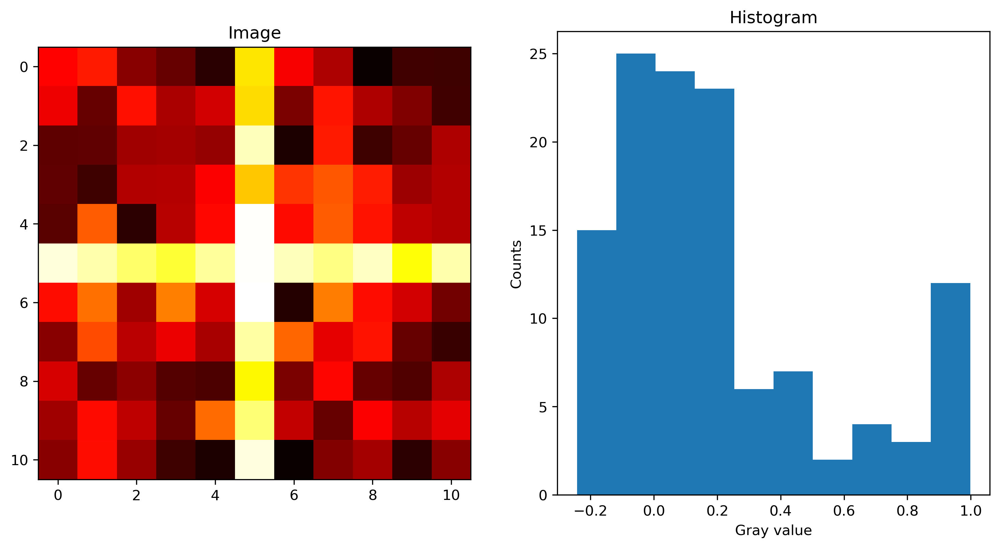

In [3]:
fig,ax = plt.subplots(1,2,figsize=(12,6))
nx = 5; ny = 5;
xx, yy   = np.meshgrid(np.arange(-nx, nx+1)/nx*2*np.pi, np.arange(-ny, ny+1)/ny*2*np.pi)
cross_im = 1.5*np.abs(np.cos(xx*yy))/(np.abs(xx*yy)+(3*np.pi/nx)) + np.random.uniform(-0.25, 0.25, size = xx.shape)       

im=ax[0].imshow(cross_im, cmap = 'hot'); ax[0].set_title("Image")
ax[1].hist(cross_im.ravel(),bins=10); ax[1].set_xlabel('Gray value'); ax[1].set_ylabel('Counts'); ax[1].set_title("Histogram");

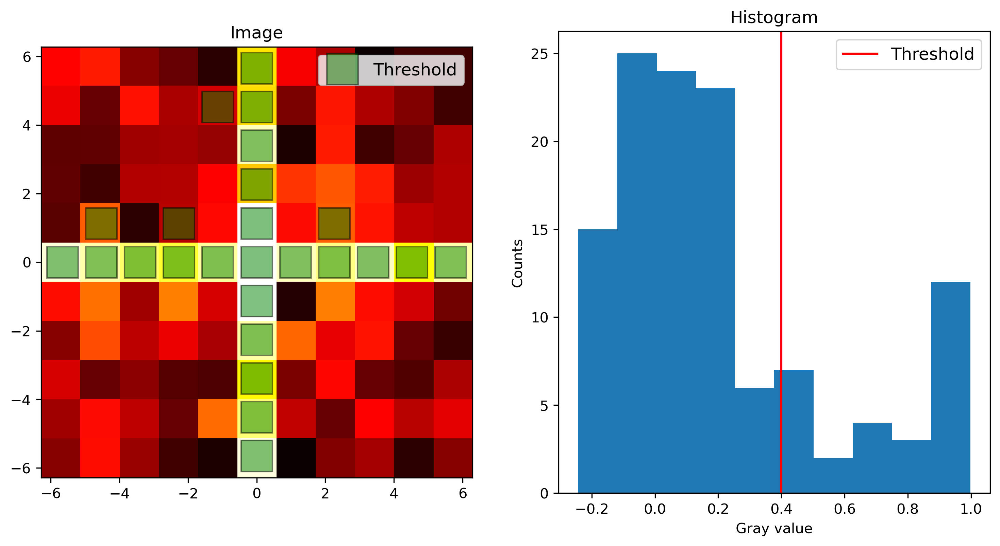

In [4]:
threshold = 0.4; thresh_img = cross_im > threshold
fig,ax = plt.subplots(1,2,figsize=(12,6))
ax[0].imshow(cross_im, cmap = 'hot', extent = [xx.min(), xx.max(), yy.min(), yy.max()]); ax[0].set_title("Image")
ax[0].plot(xx[np.where(thresh_img)]*0.9, yy[np.where(thresh_img)]*0.9,
           'ks', markerfacecolor = 'green', alpha = 0.5,label = 'Threshold', markersize = 22); ax[0].legend(fontsize=12);
ax[1].hist(cross_im.ravel(),bins=10); ax[1].axvline(x=threshold,color='r',label='Threshold'); ax[1].legend(fontsize=12); 
ax[1].set_xlabel('Gray value'); ax[1].set_ylabel('Counts'); ax[1].set_title("Histogram");

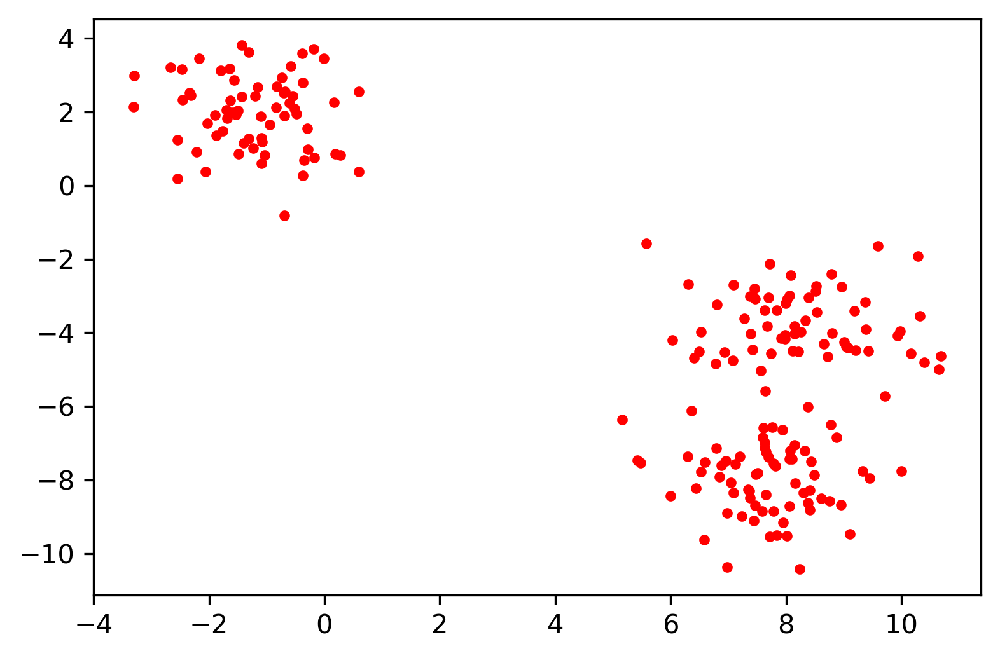

In [5]:
test_pts = pd.DataFrame(make_blobs(n_samples=200, random_state=2018)[
                        0], columns=['x', 'y'])
plt.plot(test_pts.x, test_pts.y, 'r.');

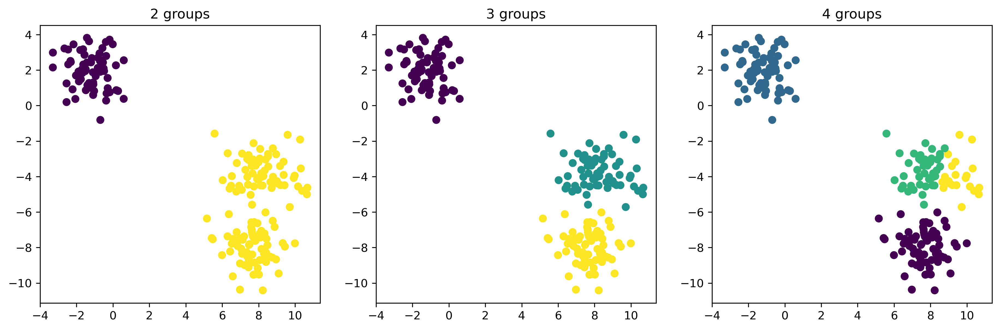

In [6]:
fig, ax = plt.subplots(1,3,figsize=(15,4.5))

for i in range(3) :
    km = KMeans(n_clusters=i+2, random_state=2018); n_grp = km.fit_predict(test_pts)
    ax[i].scatter(test_pts.x, test_pts.y, c=n_grp)
    ax[i].set_title('{0} groups'.format(i+2))

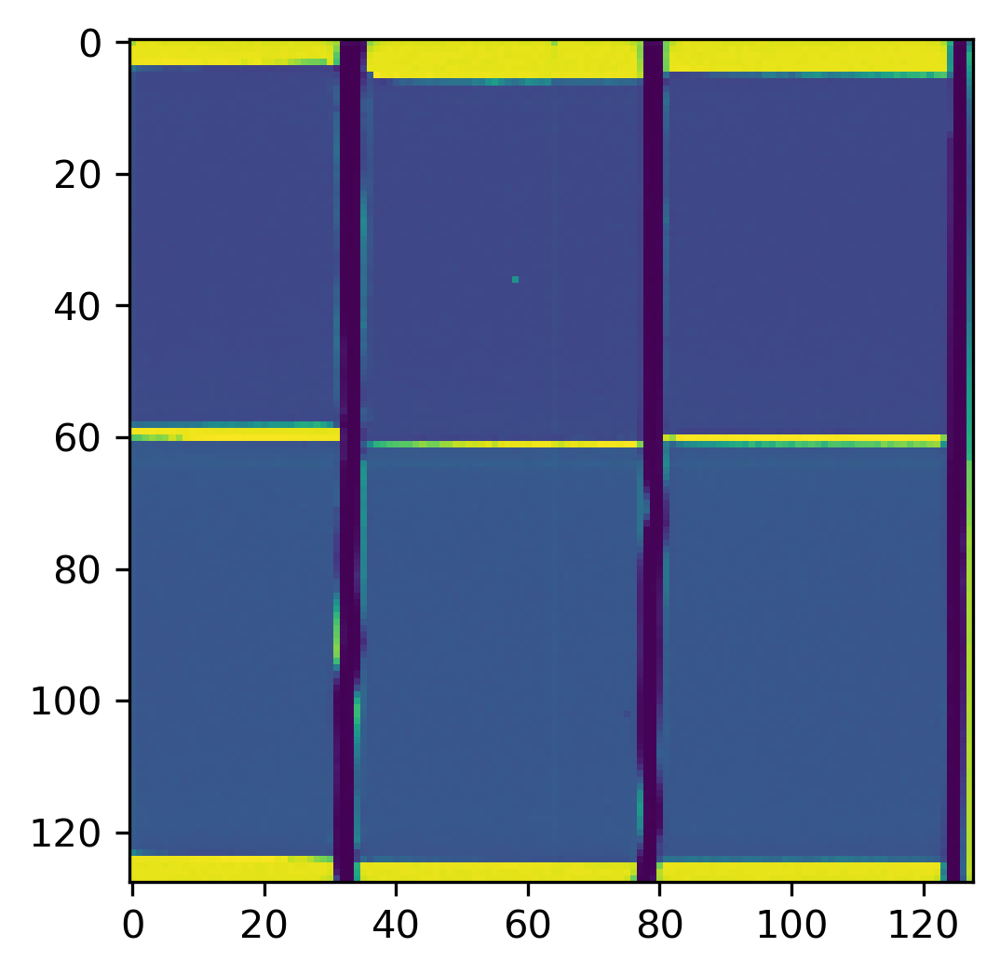

In [7]:
tof  = np.load('../data/tofdata.npy')
wtof = tof.mean(axis=2)
plt.imshow(wtof);

In [8]:
tofr=tof.reshape([tof.shape[0]*tof.shape[1],tof.shape[2]])
print("Input ToF dimensions",tof.shape)
print("Reshaped ToF data",tofr.shape)

Input ToF dimensions (128, 128, 661)
Reshaped ToF data (16384, 661)


In [9]:
km = KMeans(n_clusters=4, random_state=2018)
c  = km.fit_predict(tofr).reshape(tof.shape[:2]) # Label image
kc = km.cluster_centers_.transpose()             # cluster centroid spectra

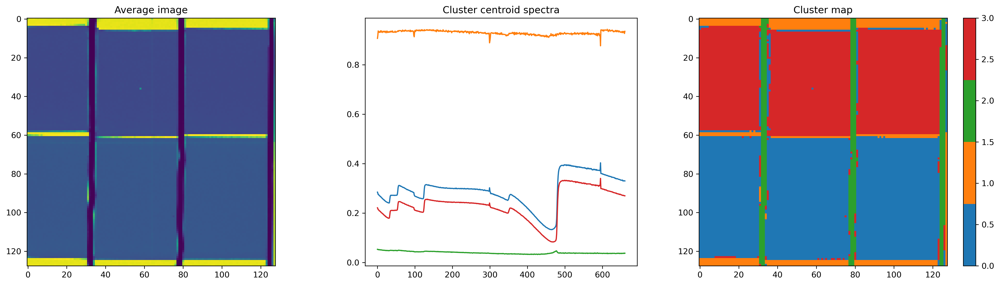

In [10]:
fig,axes = plt.subplots(1,3,figsize=(18,5)); axes=axes.ravel()
axes[0].imshow(wtof,cmap='viridis'); axes[0].set_title('Average image')
p=axes[1].plot(kc);                  axes[1].set_title('Cluster centroid spectra'); axes[1].set_aspect(tof.shape[2], adjustable='box')
cmap=ps.buildCMap(p) # Create a color map with the same colors as the plot

im=axes[2].imshow(c,cmap=cmap); plt.colorbar(im);
axes[2].set_title('Cluster map');
plt.tight_layout()

In [11]:
km = KMeans(n_clusters=10, random_state=2018)
c  = km.fit_predict(tofr).reshape(tof.shape[:2]) # Label image
kc = km.cluster_centers_.transpose()             # cluster centroid spectra

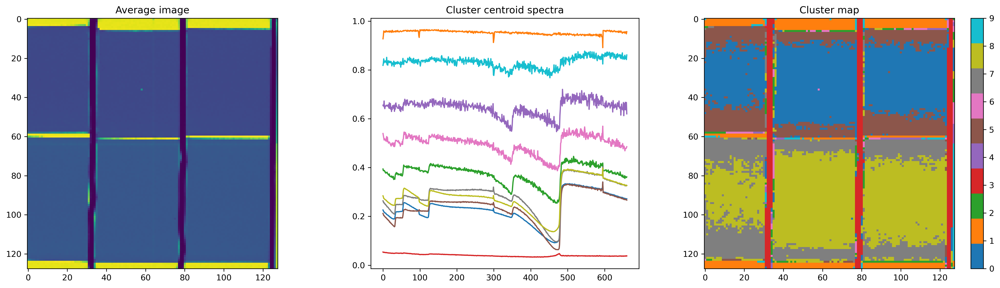

In [12]:
fig,axes = plt.subplots(1,3,figsize=(18,5)); axes=axes.ravel()
axes[0].imshow(wtof,cmap='viridis'); axes[0].set_title('Average image')
p=axes[1].plot(kc);                  axes[1].set_title('Cluster centroid spectra'); axes[1].set_aspect(tof.shape[2], adjustable='box')
cmap=ps.buildCMap(p) # Create a color map with the same colors as the plot

im=axes[2].imshow(c,cmap=cmap); plt.colorbar(im);
axes[2].set_title('Cluster map');
plt.tight_layout()

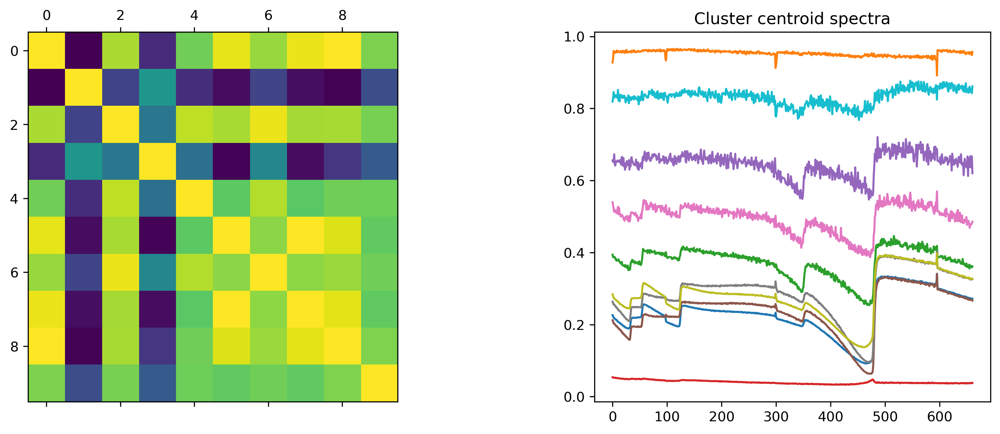

In [13]:
fig,axes = plt.subplots(1,2,figsize=(14,5)); axes=axes.ravel()
axes[0].matshow(np.corrcoef(kc.transpose()))
axes[1].plot(kc); axes[1].set_title('Cluster centroid spectra'); axes[1].set_aspect(tof.shape[2], adjustable='box')

In [14]:
del km, c, kc, tofr, tof

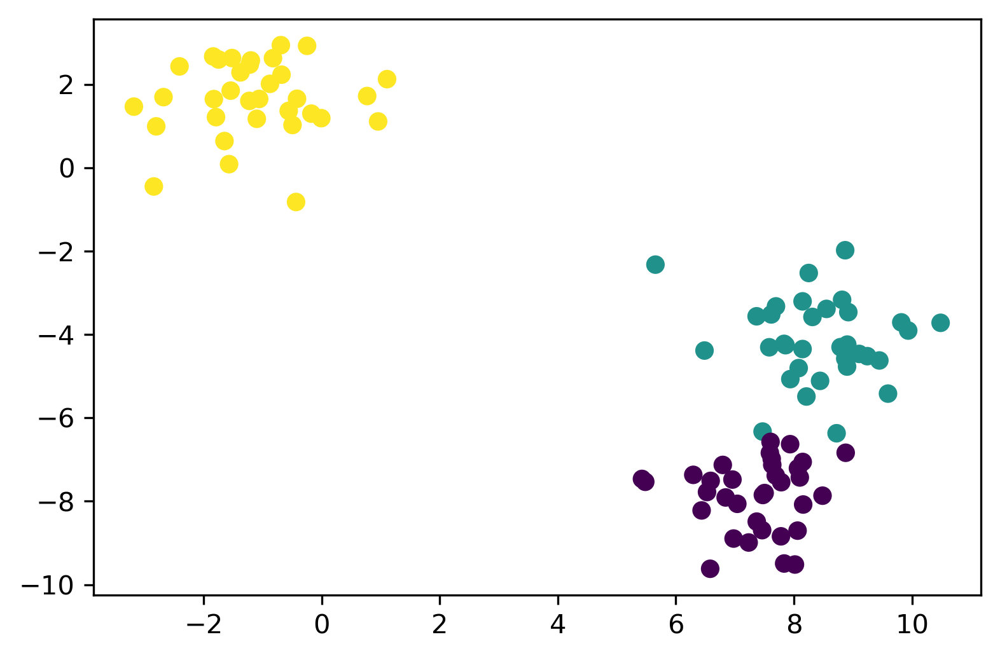

In [15]:
blob_data, blob_labels = make_blobs(n_samples=100, random_state=2018)
test_pts = pd.DataFrame(blob_data, columns=['x', 'y'])
test_pts['group_id'] = blob_labels
plt.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis');

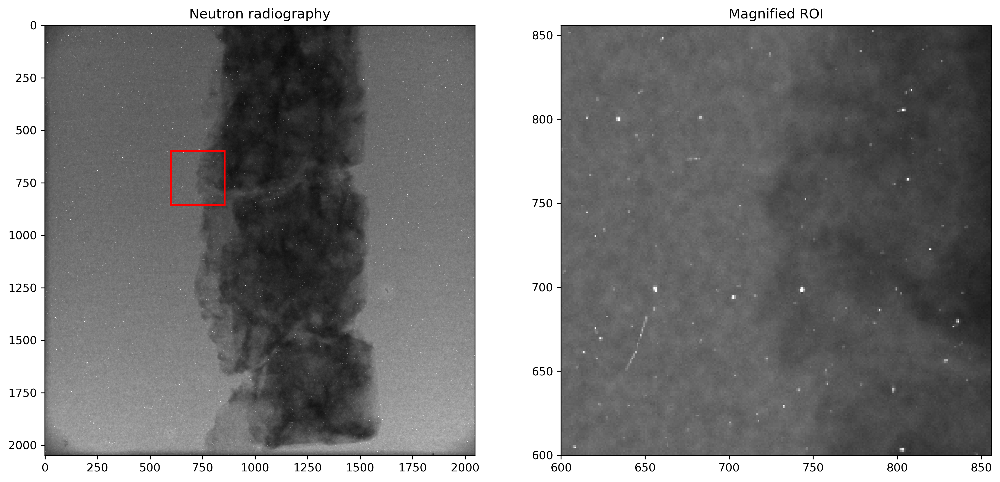

In [16]:
orig= fits.getdata('../data/spots/mixture12_00001.fits')
annotated=io.imread('../data/spots/mixture12_00001.png'); mask=(annotated[:,:,1]==0)
r=600; c=600; w=256
ps.magnifyRegion(orig,[r,c,r+w,c+w],[15,7],vmin=400,vmax=4000,title='Neutron radiography')

In [17]:
def spotCleaner(img, threshold=0.95, selem=np.ones([3,3])) :
    fimg=img.astype('float32')
    mimg = flt.median(fimg,selem=selem)
    timg = threshold < np.abs(fimg-mimg)
    cleaned = mimg * timg + fimg * (1-timg)
    return (cleaned,timg)

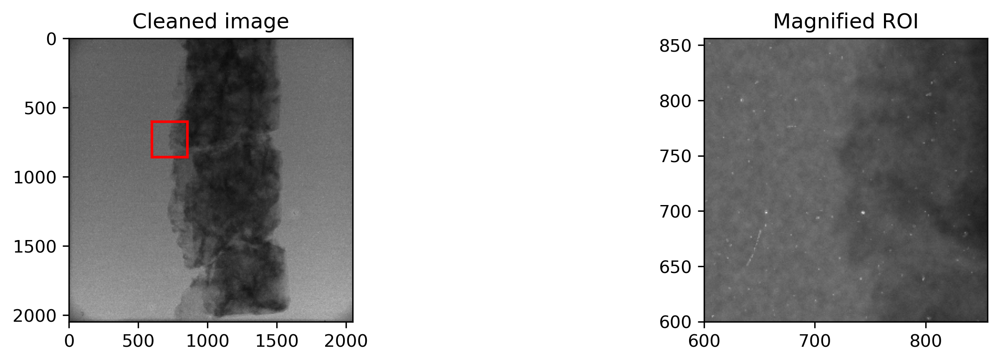

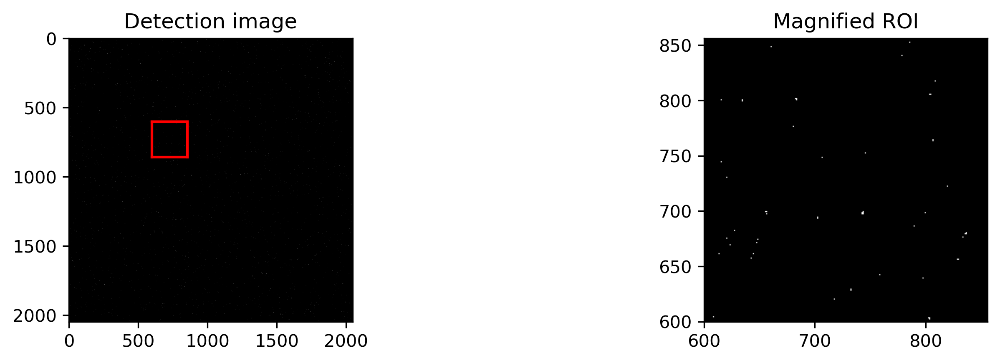

In [18]:
baseclean,timg = spotCleaner(orig,threshold=1000)
ps.magnifyRegion(baseclean,[r,c,r+w,c+w],[12,3],vmin=400,vmax=4000,title='Cleaned image')
ps.magnifyRegion(timg,[r,c,r+w,c+w],[12,3],vmin=0,vmax=1,title='Detection image')

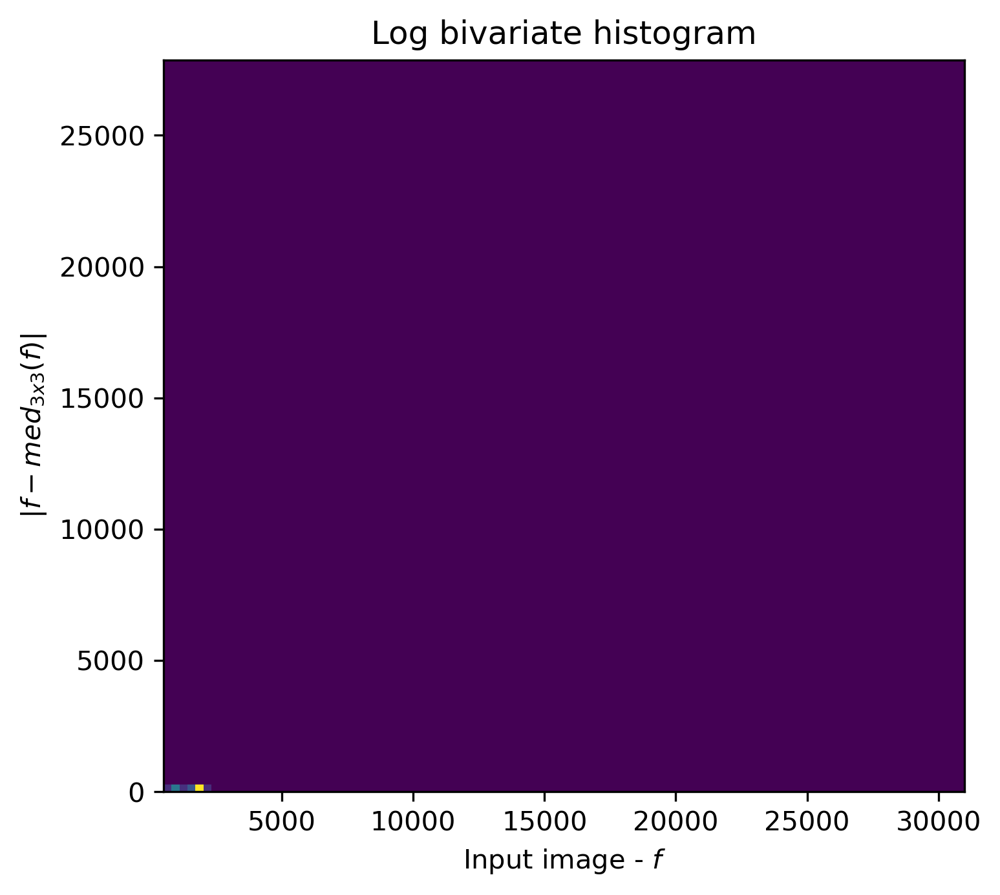

In [19]:
selem=np.ones([3,3])
forig=orig.astype('float32')
mimg = flt.median(forig,selem=selem)
d = np.abs(forig-mimg)

fig,ax=plt.subplots(1,1,figsize=(8,5))
h,x,y,u=ax.hist2d(forig[:1024,:].ravel(),d[:1024,:].ravel(), bins=100);
ax.imshow(np.log(h[::-1]+1),vmin=0,vmax=3,extent=[x.min(),x.max(),y.min(),y.max()])
ax.set_xlabel('Input image - $f$'),ax.set_ylabel('$|f-med_{3x3}(f)|$'),ax.set_title('Log bivariate histogram');

In [20]:
trainorig = forig[:,:1000].ravel()
traind    = d[:,:1000].ravel()
trainmask = mask[:,:1000].ravel()

train_pts = pd.DataFrame({'orig': trainorig, 'd': traind, 'mask':trainmask})

In [21]:
testorig = forig[:,1000:].ravel()
testd    = d[:,1000:].ravel()
testmask = mask[:,1000:].ravel()

test_pts = pd.DataFrame({'orig': testorig, 'd': testd, 'mask':testmask})

In [22]:
k_class = KNeighborsClassifier(1)
k_class.fit(train_pts[['orig', 'd']], train_pts['mask']) 

KNeighborsClassifier(n_neighbors=1)

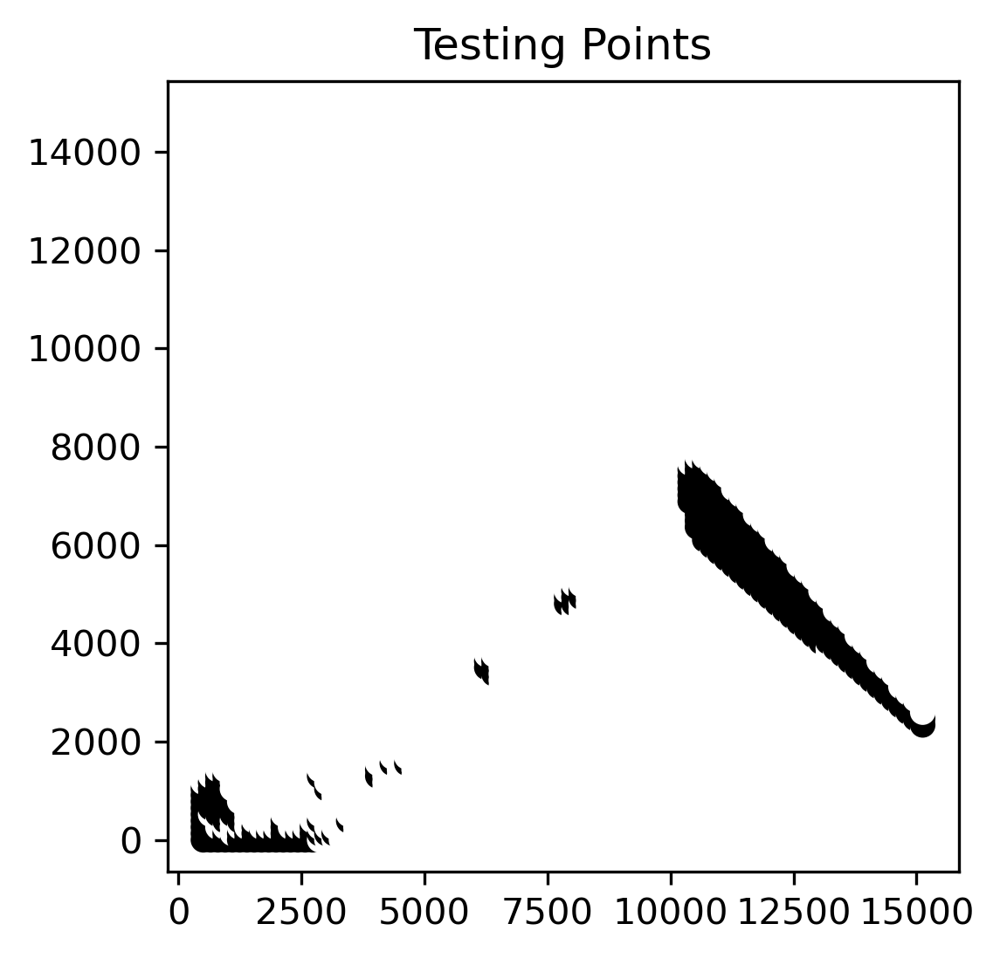

In [23]:
xx, yy = np.meshgrid(np.linspace(test_pts.orig.min(), test_pts.orig.max(), 100),
                     np.linspace(test_pts.d.min(), test_pts.d.max(), 100),indexing='ij');
grid_pts = pd.DataFrame(dict(x=xx.ravel(), y=yy.ravel()))
grid_pts['predicted_id'] = k_class.predict(grid_pts[['x', 'y']])
plt.scatter(grid_pts.x, grid_pts.y, c=grid_pts.predicted_id, cmap='gray'); plt.title('Testing Points'); plt.axis('square');

In [24]:
pred = k_class.predict(test_pts[['orig', 'd']])
pimg = pred.reshape(d[1000:,:].shape)

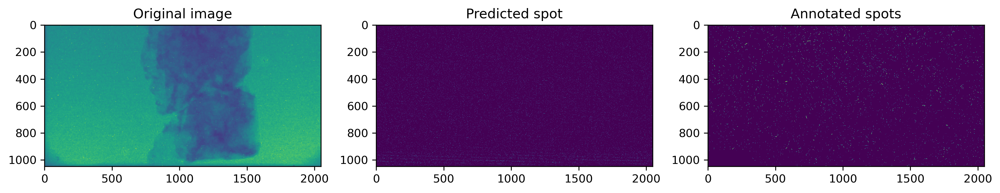

In [25]:
fig,ax = plt.subplots(1,3,figsize=(15,6))
ax[0].imshow(forig[1000:,:],vmin=0,vmax=4000), ax[0].set_title('Original image')
ax[1].imshow(pimg), ax[1].set_title('Predicted spot')
ax[2].imshow(mask[1000:,:]),ax[2].set_title('Annotated spots');

In [26]:
cmbase = confusion_matrix(mask[:,1000:].ravel(), timg[:,1000:].ravel(), normalize='all')
cmknn  = confusion_matrix(mask[:,1000:].ravel(), pimg.ravel(), normalize='all')

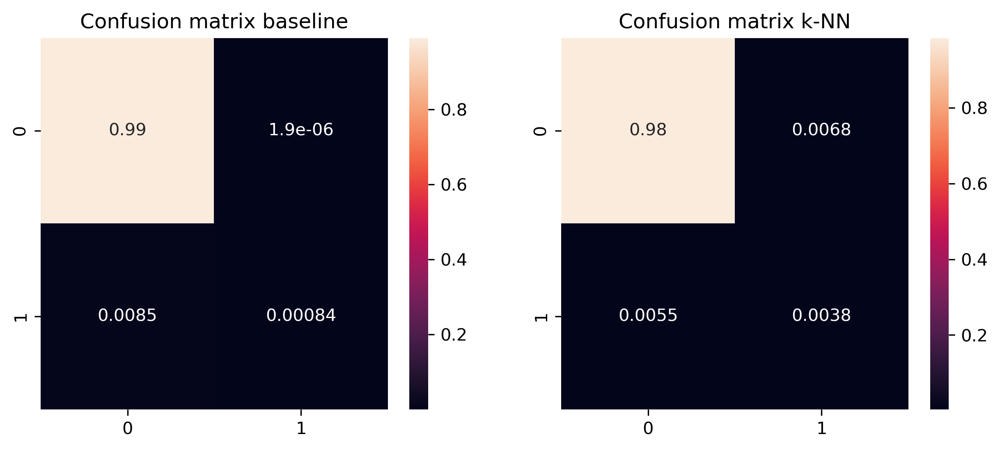

In [27]:
fig,ax = plt.subplots(1,2,figsize=(10,4))
sn.heatmap(cmbase, annot=True,ax=ax[0]), ax[0].set_title('Confusion matrix baseline');
sn.heatmap(cmknn, annot=True,ax=ax[1]), ax[1].set_title('Confusion matrix k-NN');

In [28]:
del k_class, cmbase, cmknn

In [29]:
import keras.optimizers as opt
import keras.losses as loss
import keras.metrics as metrics

In [30]:
def buildSpotUNet( base_depth = 48) :
    in_img = Input((None, None, 1), name='Image_Input')
    lay_1 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(in_img)
    lay_2 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(lay_1)
    lay_3 = MaxPooling2D(pool_size=(2, 2))(lay_2)
    lay_4 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_3)
    lay_5 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_4)
    lay_6 = MaxPooling2D(pool_size=(2, 2))(lay_5)
    lay_7 = Conv2D(base_depth*4, kernel_size=(3, 3), padding='same',activation='relu')(lay_6)
    lay_8 = Conv2D(base_depth*4, kernel_size=(3, 3), padding='same',activation='relu')(lay_7)
    lay_9 = UpSampling2D((2, 2))(lay_8)
    lay_10 = concatenate([lay_5, lay_9])
    lay_11 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_10)
    lay_12 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_11)
    lay_13 = UpSampling2D((2, 2))(lay_12)
    lay_14 = concatenate([lay_2, lay_13])
    lay_15 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(lay_14)
    lay_16 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(lay_15)
    lay_17 = Conv2D(1, kernel_size=(1, 1), padding='same',
                    activation='relu')(lay_16)
    t_unet = Model(inputs=[in_img], outputs=[lay_17], name='SpotUNET')
    return t_unet

In [31]:
t_unet = buildSpotUNet(base_depth=24)
t_unet.summary()

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


Model: "SpotUNET"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Image_Input (InputLayer)        (None, None, None, 1 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, None, 2 240         Image_Input[0][0]                
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, None, None, 2 5208        conv2d_1[0][0]                   
__________________________________________________________________________________________________
max_pooling2d_1 (MaxPooling2D)  (None, None, None, 2 0           conv2d_2[0][0]                   
___________________________________________________________________________________________

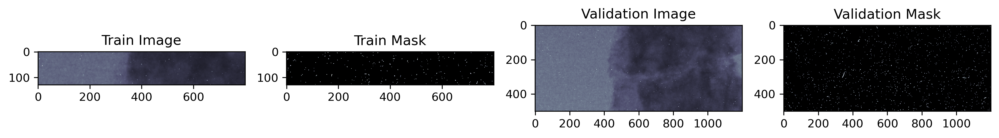

In [32]:
train_img,  valid_img  = forig[128:256, 500:1300], forig[500:1000, 300:1500]
train_mask, valid_mask = mask[128:256, 500:1300], mask[500:1000, 300:1500]
wpos = [600,600]; ww   = 512
forigc = forig[wpos[0]:(wpos[0]+ww),wpos[1]:(wpos[1]+ww)]
maskc  = mask[wpos[0]:(wpos[0]+ww),wpos[1]:(wpos[1]+ww)]

# train_img, valid_img = forig[128:256, 300:1500], forig[500:, 300:1500]
# train_mask, valid_mask = mask[128:256, 300:1500], mask[500:, 300:1500]
fig, ax = plt.subplots(1, 4, figsize=(15, 6), dpi=300); ax=ax.ravel()

ax[0].imshow(train_img, cmap='bone',vmin=0,vmax=4000);ax[0].set_title('Train Image')
ax[1].imshow(train_mask, cmap='bone'); ax[1].set_title('Train Mask')

ax[2].imshow(valid_img, cmap='bone',vmin=0,vmax=4000); ax[2].set_title('Validation Image')
ax[3].imshow(valid_mask, cmap='bone');ax[3].set_title('Validation Mask');

In [33]:
def prep_img(x, n=1): 
    return (prep_mask(x, n=n)-train_img.mean())/train_img.std()


def prep_mask(x, n=1): 
    return np.stack([np.expand_dims(x, -1)]*n, 0)

In [34]:
unet_pred = t_unet.predict(prep_img(forigc))[0, :, :, 0]

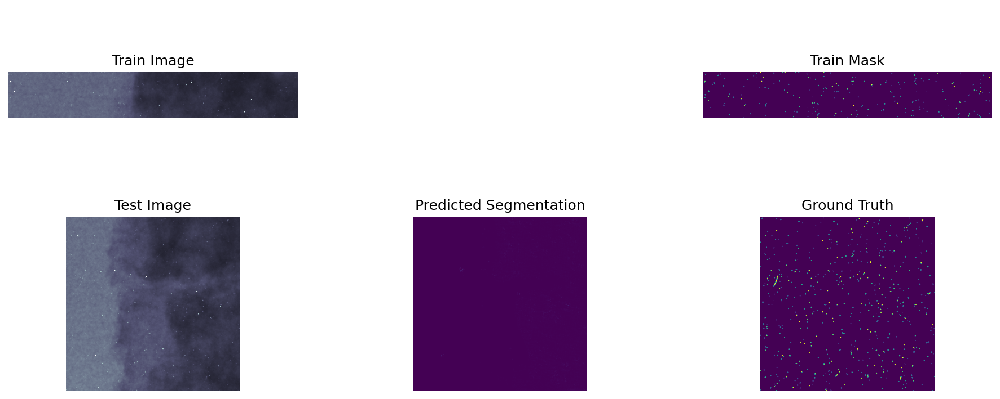

In [35]:
fig, m_axs = plt.subplots(2, 3, figsize=(15, 6), dpi=150)
for c_ax in m_axs.ravel():
    c_ax.axis('off')
((ax1, _, ax2), (ax3, ax4, ax5)) = m_axs
ax1.imshow(train_img, cmap='bone',vmin=0,vmax=4000); ax1.set_title('Train Image')
ax2.imshow(train_mask, cmap='viridis'); ax2.set_title('Train Mask')

ax3.imshow(forigc, cmap='bone',vmin=0, vmax=4000); ax3.set_title('Test Image')
ax4.imshow(unet_pred, cmap='viridis', vmin=0, vmax=1); ax4.set_title('Predicted Segmentation')

ax5.imshow(maskc, cmap='viridis'); ax5.set_title('Ground Truth');

In [36]:
mlist = [
      metrics.TruePositives(name='tp'),        metrics.FalsePositives(name='fp'), 
      metrics.TrueNegatives(name='tn'),        metrics.FalseNegatives(name='fn'), 
      metrics.BinaryAccuracy(name='accuracy'), metrics.Precision(name='precision'),
      metrics.Recall(name='recall'),           metrics.AUC(name='auc'),
      metrics.MeanAbsoluteError(name='mae')]

t_unet.compile(
    loss=loss.BinaryCrossentropy(),  # we use the binary cross-entropy to optimize
    optimizer=opt.Adam(lr=1e-3),     # we use ADAM to optimize
    metrics=mlist                    # we keep track of the metrics in mlist
)

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [37]:
loss_history = t_unet.fit(prep_img(train_img, n=3),
                          prep_mask(train_mask, n=3),
                          validation_data=(prep_img(valid_img),
                                           prep_mask(valid_mask)),
                          epochs=20,
                          verbose = 1)


Train on 3 samples, validate on 1 samples


Epoch 1/20


3/3 [==============================] - 10s 3s/step - loss: 0.0953 - tp: 0.0000e+00 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2544.0000 - accuracy: 0.9917 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.5670 - mae: 0.0113 - val_loss: 0.1000 - val_tp: 4.0000 - val_fp: 1.0000 - val_tn: 593515.0000 - val_fn: 6480.0000 - val_accuracy: 0.9892 - val_precision: 0.8000 - val_recall: 6.1690e-04 - val_auc: 0.5722 - val_mae: 0.0183


Epoch 2/20


3/3 [==============================] - 7s 2s/step - loss: 0.0872 - tp: 0.0000e+00 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2544.0000 - accuracy: 0.9917 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.5448 - mae: 0.0140 - val_loss: 0.1013 - val_tp: 16.0000 - val_fp: 24.0000 - val_tn: 593492.0000 - val_fn: 6468.0000 - val_accuracy: 0.9892 - val_precision: 0.4000 - val_recall: 0.0025 - val_auc: 0.6857 - val_mae: 0.0806


Epoch 3/20


3/3 [==============================] - 7s 2s/step - loss: 0.0932 - tp: 3.0000 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2541.0000 - accuracy: 0.9917 - precision: 1.0000 - recall: 0.0012 - auc: 0.7306 - mae: 0.0773 - val_loss: 0.0647 - val_tp: 21.0000 - val_fp: 12.0000 - val_tn: 593504.0000 - val_fn: 6463.0000 - val_accuracy: 0.9892 - val_precision: 0.6364 - val_recall: 0.0032 - val_auc: 0.7854 - val_mae: 0.0416


Epoch 4/20


3/3 [==============================] - 7s 2s/step - loss: 0.0528 - tp: 9.0000 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2535.0000 - accuracy: 0.9917 - precision: 1.0000 - recall: 0.0035 - auc: 0.8136 - mae: 0.0345 - val_loss: 0.0912 - val_tp: 16.0000 - val_fp: 3.0000 - val_tn: 593513.0000 - val_fn: 6468.0000 - val_accuracy: 0.9892 - val_precision: 0.8421 - val_recall: 0.0025 - val_auc: 0.7554 - val_mae: 0.0110


Epoch 5/20


3/3 [==============================] - 7s 2s/step - loss: 0.0768 - tp: 3.0000 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2541.0000 - accuracy: 0.9917 - precision: 1.0000 - recall: 0.0012 - auc: 0.7298 - mae: 0.0085 - val_loss: 0.1034 - val_tp: 18.0000 - val_fp: 3.0000 - val_tn: 593513.0000 - val_fn: 6466.0000 - val_accuracy: 0.9892 - val_precision: 0.8571 - val_recall: 0.0028 - val_auc: 0.7161 - val_mae: 0.0108


Epoch 6/20


3/3 [==============================] - 7s 2s/step - loss: 0.0869 - tp: 6.0000 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2538.0000 - accuracy: 0.9917 - precision: 1.0000 - recall: 0.0024 - auc: 0.6804 - mae: 0.0084 - val_loss: 0.0679 - val_tp: 35.0000 - val_fp: 6.0000 - val_tn: 593510.0000 - val_fn: 6449.0000 - val_accuracy: 0.9892 - val_precision: 0.8537 - val_recall: 0.0054 - val_auc: 0.8436 - val_mae: 0.0113


Epoch 7/20


3/3 [==============================] - 7s 2s/step - loss: 0.0637 - tp: 15.0000 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2529.0000 - accuracy: 0.9918 - precision: 1.0000 - recall: 0.0059 - auc: 0.7864 - mae: 0.0089 - val_loss: 0.0535 - val_tp: 61.0000 - val_fp: 18.0000 - val_tn: 593498.0000 - val_fn: 6423.0000 - val_accuracy: 0.9893 - val_precision: 0.7722 - val_recall: 0.0094 - val_auc: 0.8681 - val_mae: 0.0269


Epoch 8/20


3/3 [==============================] - 7s 2s/step - loss: 0.0472 - tp: 42.0000 - fp: 3.0000 - tn: 304653.0000 - fn: 2502.0000 - accuracy: 0.9918 - precision: 0.9333 - recall: 0.0165 - auc: 0.8398 - mae: 0.0205 - val_loss: 0.0584 - val_tp: 99.0000 - val_fp: 34.0000 - val_tn: 593482.0000 - val_fn: 6385.0000 - val_accuracy: 0.9893 - val_precision: 0.7444 - val_recall: 0.0153 - val_auc: 0.9168 - val_mae: 0.0402


Epoch 9/20


3/3 [==============================] - 7s 2s/step - loss: 0.0503 - tp: 63.0000 - fp: 18.0000 - tn: 304638.0000 - fn: 2481.0000 - accuracy: 0.9919 - precision: 0.7778 - recall: 0.0248 - auc: 0.9258 - mae: 0.0368 - val_loss: 0.0466 - val_tp: 93.0000 - val_fp: 26.0000 - val_tn: 593490.0000 - val_fn: 6391.0000 - val_accuracy: 0.9893 - val_precision: 0.7815 - val_recall: 0.0143 - val_auc: 0.9232 - val_mae: 0.0247


Epoch 10/20


3/3 [==============================] - 7s 2s/step - loss: 0.0383 - tp: 63.0000 - fp: 9.0000 - tn: 304647.0000 - fn: 2481.0000 - accuracy: 0.9919 - precision: 0.8750 - recall: 0.0248 - auc: 0.9284 - mae: 0.0226 - val_loss: 0.0651 - val_tp: 63.0000 - val_fp: 12.0000 - val_tn: 593504.0000 - val_fn: 6421.0000 - val_accuracy: 0.9893 - val_precision: 0.8400 - val_recall: 0.0097 - val_auc: 0.8483 - val_mae: 0.0118


Epoch 11/20


3/3 [==============================] - 7s 2s/step - loss: 0.0494 - tp: 39.0000 - fp: 6.0000 - tn: 304650.0000 - fn: 2505.0000 - accuracy: 0.9918 - precision: 0.8667 - recall: 0.0153 - auc: 0.8490 - mae: 0.0093 - val_loss: 0.0705 - val_tp: 58.0000 - val_fp: 10.0000 - val_tn: 593506.0000 - val_fn: 6426.0000 - val_accuracy: 0.9893 - val_precision: 0.8529 - val_recall: 0.0089 - val_auc: 0.8336 - val_mae: 0.0114


Epoch 12/20


3/3 [==============================] - 7s 2s/step - loss: 0.0533 - tp: 36.0000 - fp: 6.0000 - tn: 304650.0000 - fn: 2508.0000 - accuracy: 0.9918 - precision: 0.8571 - recall: 0.0142 - auc: 0.8339 - mae: 0.0091 - val_loss: 0.0549 - val_tp: 78.0000 - val_fp: 13.0000 - val_tn: 593503.0000 - val_fn: 6406.0000 - val_accuracy: 0.9893 - val_precision: 0.8571 - val_recall: 0.0120 - val_auc: 0.8894 - val_mae: 0.0118


Epoch 13/20


3/3 [==============================] - 7s 2s/step - loss: 0.0407 - tp: 54.0000 - fp: 9.0000 - tn: 304647.0000 - fn: 2490.0000 - accuracy: 0.9919 - precision: 0.8571 - recall: 0.0212 - auc: 0.8960 - mae: 0.0094 - val_loss: 0.0405 - val_tp: 112.0000 - val_fp: 27.0000 - val_tn: 593489.0000 - val_fn: 6372.0000 - val_accuracy: 0.9893 - val_precision: 0.8058 - val_recall: 0.0173 - val_auc: 0.9449 - val_mae: 0.0160


Epoch 14/20


3/3 [==============================] - 7s 2s/step - loss: 0.0305 - tp: 78.0000 - fp: 18.0000 - tn: 304638.0000 - fn: 2466.0000 - accuracy: 0.9919 - precision: 0.8125 - recall: 0.0307 - auc: 0.9534 - mae: 0.0127 - val_loss: 0.0466 - val_tp: 141.0000 - val_fp: 36.0000 - val_tn: 593480.0000 - val_fn: 6343.0000 - val_accuracy: 0.9894 - val_precision: 0.7966 - val_recall: 0.0217 - val_auc: 0.9441 - val_mae: 0.0277


Epoch 15/20


3/3 [==============================] - 7s 2s/step - loss: 0.0394 - tp: 93.0000 - fp: 30.0000 - tn: 304626.0000 - fn: 2451.0000 - accuracy: 0.9919 - precision: 0.7561 - recall: 0.0366 - auc: 0.9556 - mae: 0.0260 - val_loss: 0.0435 - val_tp: 146.0000 - val_fp: 38.0000 - val_tn: 593478.0000 - val_fn: 6338.0000 - val_accuracy: 0.9894 - val_precision: 0.7935 - val_recall: 0.0225 - val_auc: 0.9454 - val_mae: 0.0234


Epoch 16/20


3/3 [==============================] - 7s 2s/step - loss: 0.0355 - tp: 93.0000 - fp: 30.0000 - tn: 304626.0000 - fn: 2451.0000 - accuracy: 0.9919 - precision: 0.7561 - recall: 0.0366 - auc: 0.9592 - mae: 0.0213 - val_loss: 0.0414 - val_tp: 133.0000 - val_fp: 28.0000 - val_tn: 593488.0000 - val_fn: 6351.0000 - val_accuracy: 0.9894 - val_precision: 0.8261 - val_recall: 0.0205 - val_auc: 0.9373 - val_mae: 0.0137


Epoch 17/20


3/3 [==============================] - 7s 2s/step - loss: 0.0290 - tp: 90.0000 - fp: 24.0000 - tn: 304632.0000 - fn: 2454.0000 - accuracy: 0.9919 - precision: 0.7895 - recall: 0.0354 - auc: 0.9561 - mae: 0.0108 - val_loss: 0.0487 - val_tp: 126.0000 - val_fp: 26.0000 - val_tn: 593490.0000 - val_fn: 6358.0000 - val_accuracy: 0.9893 - val_precision: 0.8289 - val_recall: 0.0194 - val_auc: 0.9122 - val_mae: 0.0118


Epoch 18/20


3/3 [==============================] - 7s 2s/step - loss: 0.0357 - tp: 84.0000 - fp: 15.0000 - tn: 304641.0000 - fn: 2460.0000 - accuracy: 0.9919 - precision: 0.8485 - recall: 0.0330 - auc: 0.9180 - mae: 0.0093 - val_loss: 0.0508 - val_tp: 131.0000 - val_fp: 26.0000 - val_tn: 593490.0000 - val_fn: 6353.0000 - val_accuracy: 0.9894 - val_precision: 0.8344 - val_recall: 0.0202 - val_auc: 0.9053 - val_mae: 0.0115


Epoch 19/20


3/3 [==============================] - 7s 2s/step - loss: 0.0375 - tp: 84.0000 - fp: 21.0000 - tn: 304635.0000 - fn: 2460.0000 - accuracy: 0.9919 - precision: 0.8000 - recall: 0.0330 - auc: 0.9090 - mae: 0.0090 - val_loss: 0.0473 - val_tp: 149.0000 - val_fp: 28.0000 - val_tn: 593488.0000 - val_fn: 6335.0000 - val_accuracy: 0.9894 - val_precision: 0.8418 - val_recall: 0.0230 - val_auc: 0.9182 - val_mae: 0.0116


Epoch 20/20


3/3 [==============================] - 7s 2s/step - loss: 0.0358 - tp: 99.0000 - fp: 27.0000 - tn: 304629.0000 - fn: 2445.0000 - accuracy: 0.9920 - precision: 0.7857 - recall: 0.0389 - auc: 0.9211 - mae: 0.0091 - val_loss: 0.0409 - val_tp: 169.0000 - val_fp: 41.0000 - val_tn: 593475.0000 - val_fn: 6315.0000 - val_accuracy: 0.9894 - val_precision: 0.8048 - val_recall: 0.0261 - val_auc: 0.9380 - val_mae: 0.0130


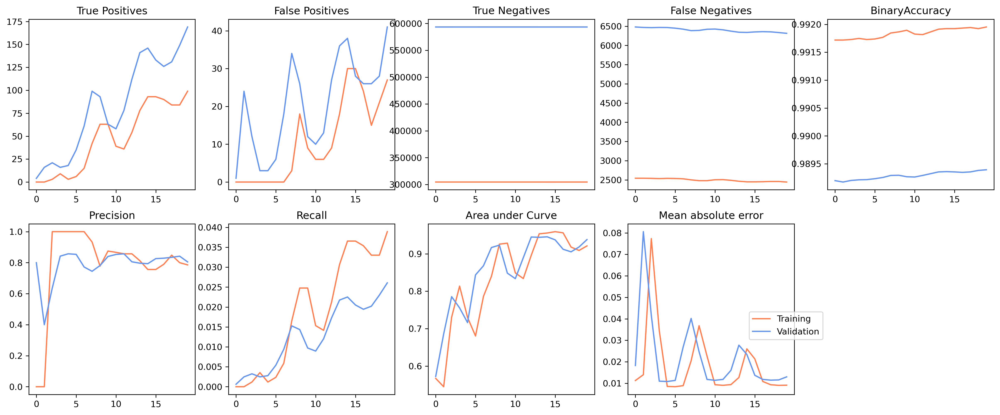

In [38]:
titleDict = {'tp': "True Positives",'fp': "False Positives",'tn': "True Negatives",'fn': "False Negatives", 'accuracy':"BinaryAccuracy",'precision': "Precision",'recall':"Recall",'auc': "Area under Curve", 'mae': "Mean absolute error"}

fig,ax = plt.subplots(2,5, figsize=(20,8), dpi=300)
ax =ax.ravel()
for idx,key in enumerate(titleDict.keys()): 
    ax[idx].plot(loss_history.epoch, loss_history.history[key], color='coral', label='Training')
    ax[idx].plot(loss_history.epoch, loss_history.history['val_'+key], color='cornflowerblue', label='Validation')
    ax[idx].set_title(titleDict[key]); 

ax[9].axis('off');
axLine, axLabel = ax[0].get_legend_handles_labels() # Take the lables and plot line information from the first panel
lines =[]; labels = []; lines.extend(axLine); labels.extend(axLabel);fig.legend(lines, labels, bbox_to_anchor=(0.7, 0.3), loc='upper left');

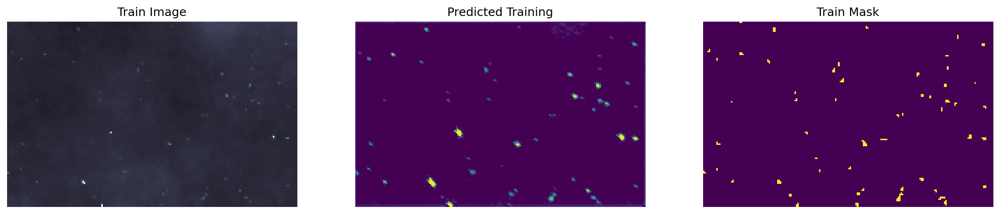

In [39]:
unet_train_pred = t_unet.predict(prep_img(train_img[:,wpos[1]:(wpos[1]+ww)]))[0, :, :, 0]

fig, m_axs = plt.subplots(1, 3, figsize=(18, 4), dpi=150); m_axs= m_axs.ravel(); 
for c_ax in m_axs: c_ax.axis('off')

m_axs[0].imshow(train_img[:,wpos[1]:(wpos[1]+ww)], cmap='bone', vmin=0, vmax=4000), m_axs[0].set_title('Train Image')
m_axs[1].imshow(unet_train_pred, cmap='viridis', vmin=0, vmax=0.2), m_axs[1].set_title('Predicted Training')
m_axs[2].imshow(train_mask[:,wpos[1]:(wpos[1]+ww)], cmap='viridis'), m_axs[2].set_title('Train Mask');


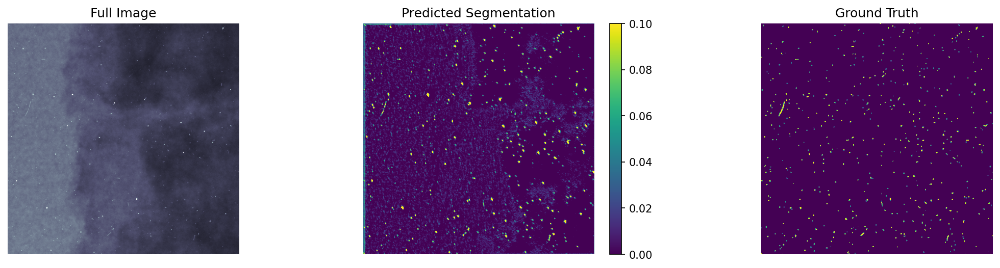

In [40]:
unet_pred = t_unet.predict(prep_img(forigc))[0, :, :, 0]

fig, m_axs = plt.subplots(1, 3, figsize=(18, 4), dpi=150); m_axs = m_axs.ravel() ; 
for c_ax in m_axs: c_ax.axis('off')
m_axs[0].imshow(forigc, cmap='bone', vmin=0, vmax=4000); m_axs[0].set_title('Full Image')
f1=m_axs[1].imshow(unet_pred, cmap='viridis', vmin=0, vmax=0.1); m_axs[1].set_title('Predicted Segmentation'); fig.colorbar(f1,ax=m_axs[1]);
m_axs[2].imshow(maskc,cmap='viridis'); m_axs[2].set_title('Ground Truth');

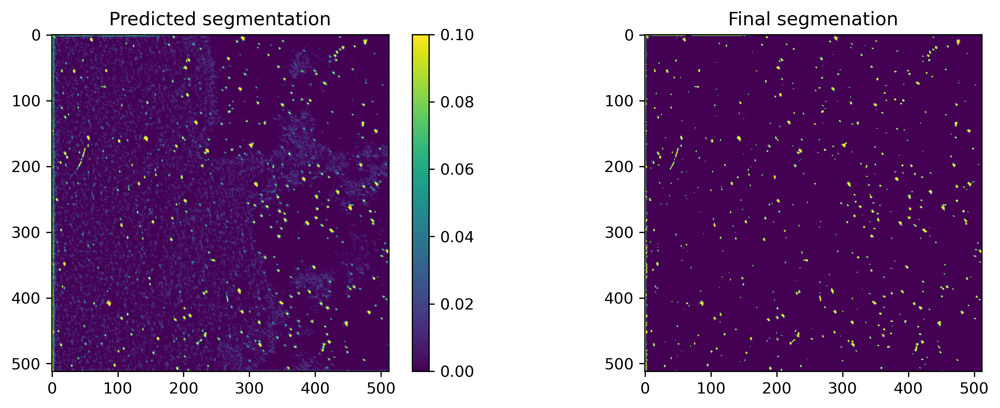

In [41]:
fig, ax = plt.subplots(1,2, figsize=(12,4))
ax0=ax[0].imshow(unet_pred, vmin=0, vmax=0.1); ax[0].set_title('Predicted segmentation'); fig.colorbar(ax0,ax=ax[0])
ax[1].imshow(0.05<unet_pred), ax[1].set_title('Final segmenation');

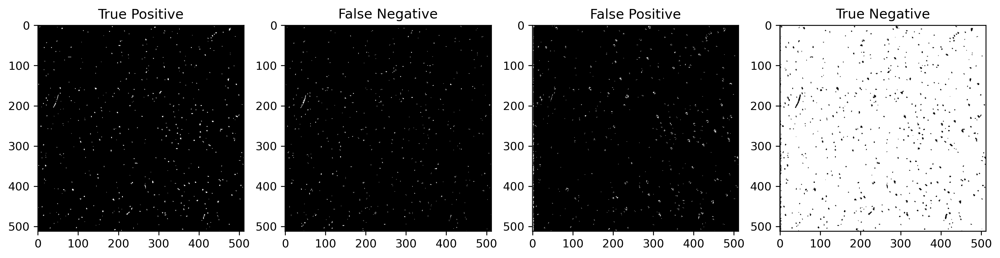

In [42]:
gt = maskc
pr = 0.05<unet_pred
ps.showHitCases(gt,pr,cmap='gray')

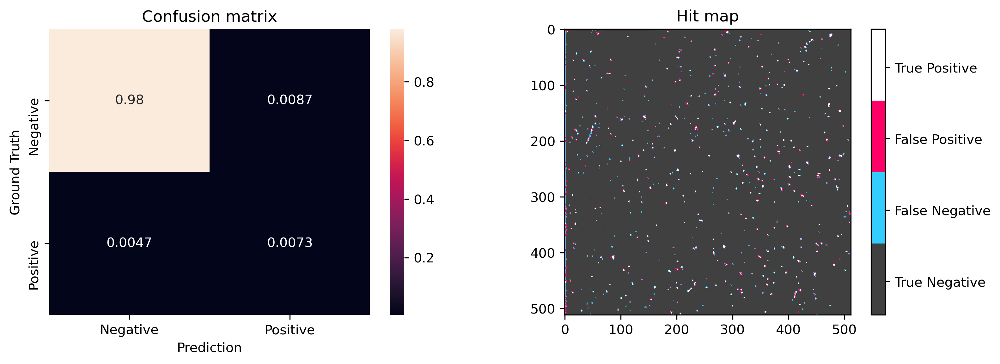

In [43]:
fig, ax = plt.subplots(1,2,figsize=(12,4))

ps.showHitMap(gt,pr,ax=ax)